## Setup environment for google colab & Download data

In [ ]:
%tensorflow_version 2.x
!python colab_setup.py
import os
os.environ['PYTHONPATH'] += ':/content/models/research/:/content/models/research/slim/'
os.environ['PYTHONPATH'] += ":/content/models"
!python3 -c 'import tensorflow as tf; print(tf.__version__)'
%cd Object_detection_in_urban_environments/

     |████████████████████████████████| 1.5MB 4.4MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
Archive:  Object_detection_in_urban_environments.zip
  inflating: Object_detection_in_urban_environments/.DS_Store  
   creating: Object_detection_in_urban_environments/.git/
 extracting: Object_detection_in_urban_environments/.git/COMMIT_EDITMSG  
  inflating: Object_detection_in_urban_environments/.git/config  
  inflating: Object_detection_in_urban_environments/.git/description  
 extracting: Object_detection_in_urban_environments/.git/HEAD  
   creating: Object_detection_in_urban_environments/.git/hooks/
  inflating: Object_detection_in_urban_environments/.git/hooks/applypatch-msg.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/commit-msg.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/post-update.sample  
  inflating: Object_detection_in_urban_environments/.git/hooks/p

In [ ]:
!python download_process.py --data_dir ../data/ --temp_dir .

Streaming output truncated to the last 5000 lines.
(pid=1915) 2020-11-28 18:12:40,169 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=1915) 2020-11-28 18:12:40,169 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=1915) 2020-11-28 18:12:40,169 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=1915) 2020-11-28 18:12:40,169 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid=1915) 2020-11-28 18:12:40,169 INFO     Downloading gs://waymo_open_dataset_v_1_2_0_individual_files/training/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord
(pid

# Explore the dataset


In this notebook, we will perform an EDA (Exploratory Data Analysis) on the processed Waymo dataset (data in the `processed` folder). In the first part, you will create a function to display 

In [ ]:
import os
from utils import get_dataset
import tensorflow.compat.v1 as tf
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle
%matplotlib inline

In [ ]:
dataset = get_dataset("../data/processed/*.tfrecord")

INFO:tensorflow:Reading unweighted datasets: ['../data/processed/*.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['../data/processed/*.tfrecord']
INFO:tensorflow:Number of filenames to read: 100


## Write a function to display an image and the bounding boxes

Implement the `display_instances` function below. This function takes a batch as an input and display an image with its corresponding bounding boxes. The only requirement is that the classes should be color coded (eg, vehicles in red, pedestrians in blue, cyclist in green).

In [ ]:
def display_instances(batch):
    """
    This function takes a batch from the dataset and display the image with 
    the associated bounding boxes.
    """
    # set boxes
    file_name = batch['filename'].numpy().decode('utf-8')
    image = batch['image'].numpy()
    classes = batch['groundtruth_classes'].numpy()
    boxes = batch['groundtruth_boxes'].numpy()
    # we need to unnormalized the boxes for plotting
    hgt, wdt, _ = image.shape
    boxes[:, [1, 3]] *= hgt
    boxes[:, [0, 2]] *= wdt
    
    ## plot image + boxes 
    # Set colors
    pink = '#EB70AA'
    cyan = '#00ffff'
    gold = '#FFD700'
    colors_dict = {1 : pink, 2 : cyan, 4 : gold}
    # plot
    _, ax = plt.subplots(1, figsize=(10,12))
    ax.imshow(image.astype(np.uint8))
    ax.set_title(file_name)
    for box, class_i in zip(boxes, classes):
        y1 = box[0]
        x1 = box[1]
        y2 = box[2]
        x2 = box[3]
        width = x2 - x1 
        height = y2 -y1
        box_img = Rectangle((x1, y1), width, height, linewidth=2, 
                        facecolor='none', edgecolor=colors_dict[class_i])
        ax.add_patch(box_img)
    plt.show()

## Display 10 images 

Using the dataset created in the second cell and the function you just coded, display 10 random images with the associated bounding boxes. You can use the methods `take` and `shuffle` on the dataset.

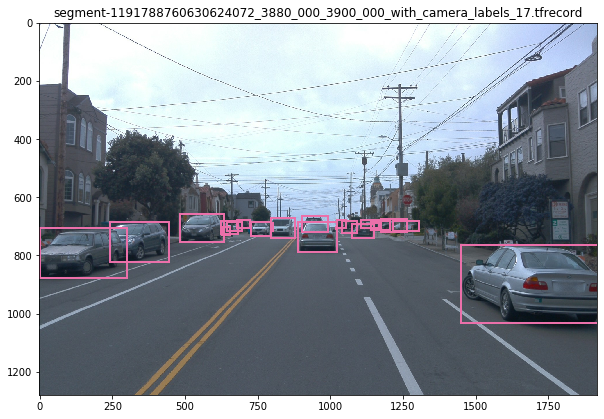

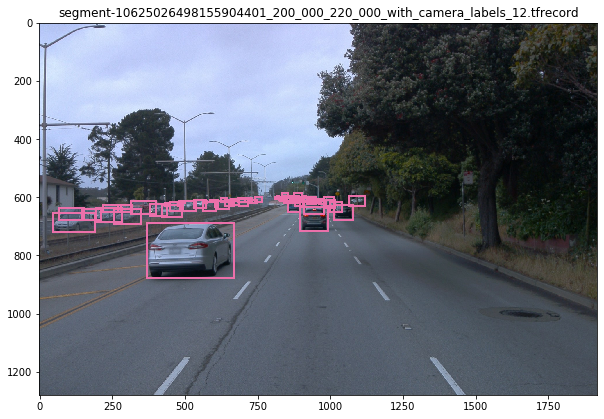

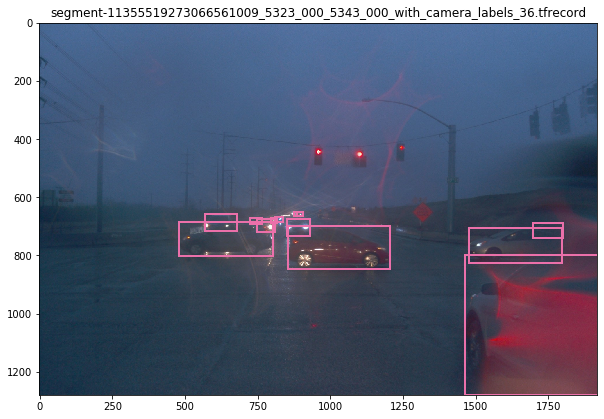

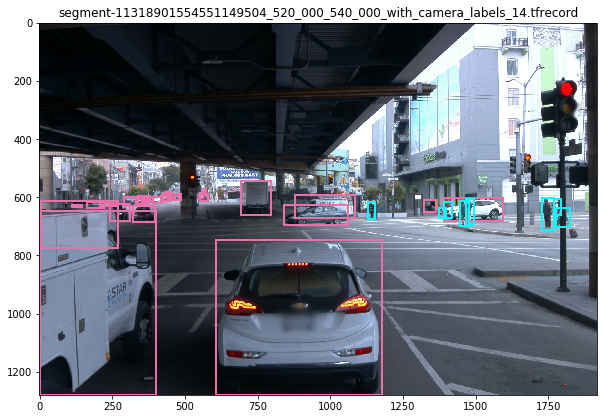

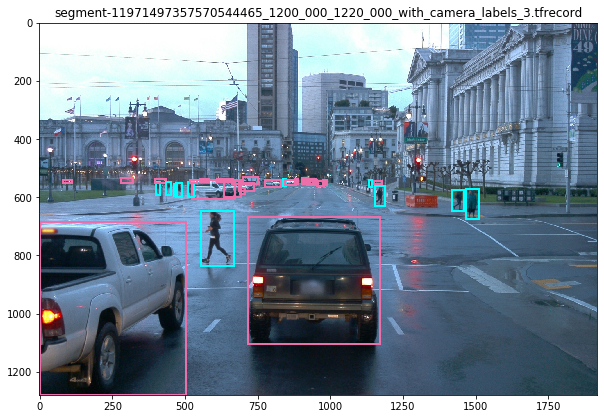

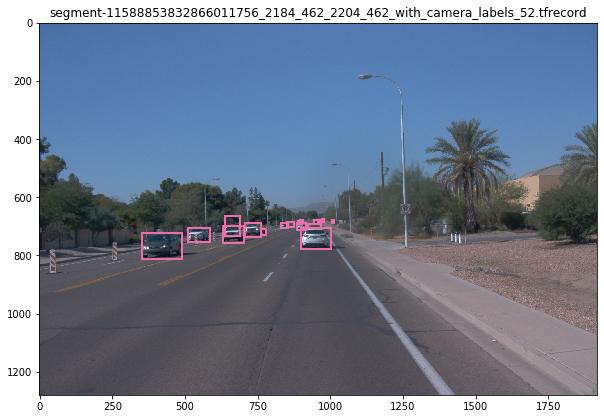

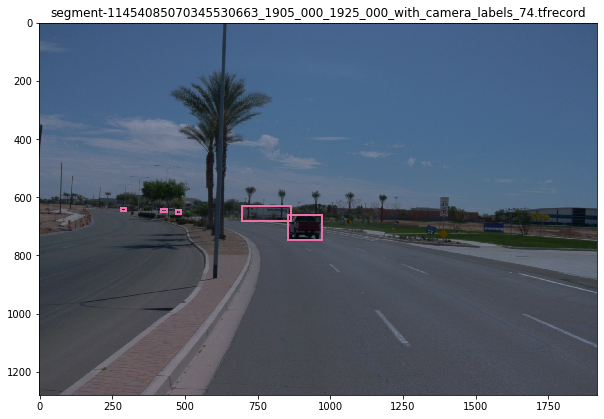

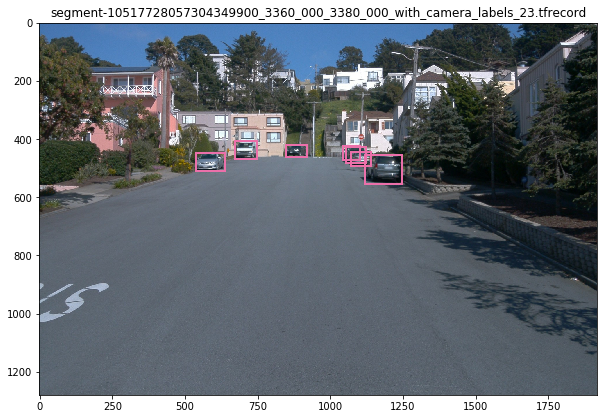

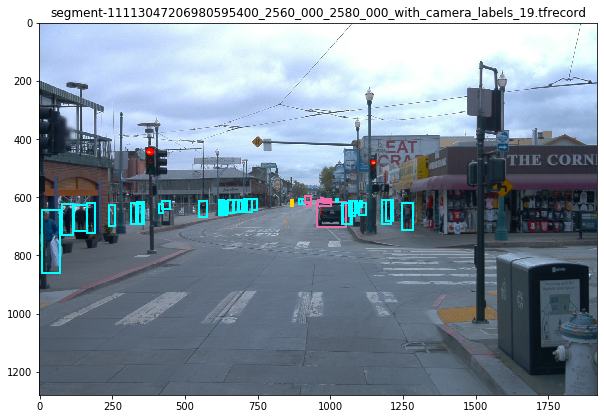

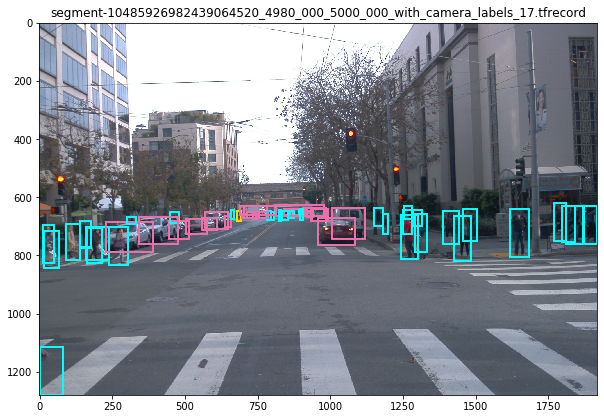

In [ ]:
## STUDENT SOLUTION HERE

dataset.shuffle(100)
dataset.repeat(1)
for batch in dataset.take(10):
    display_instances(batch)

## Additional EDA

In this last part, you are free to perform any additional analysis of the dataset. What else would like to know about the data?
For example, think about data distribution. So far, you have only looked at a single file...

In [ ]:
def count_dataset(path):
    
    filenames = os.listdir(path)
    num_files = sum(os.path.isfile(os.path.join(path, f)) for f in os.listdir(path))
    print(filenames)
    counter = 0
    for i,file in enumerate(filenames):
        ds = tf.data.TFRecordDataset(path + file)
        for j, _ in ds.enumerate():
            continue
        counter += j.numpy()
        print(f'\rcomputing files... {i+1}/{num_files}',end='',flush=True)
    print('\nDataset count: ' + str(counter))
    return counter

In [ ]:
processed_dataset_count = count_dataset('../data/processed/')

computing files... 100/100
Dataset count: 19703


19703

In [ ]:
# labels classes {'vehicle': 1, 'pedestrian': 2, 'cyclist': 4}
counter_dict = {1:0,2:0,4:0}
for i, sample in dataset.enumerate():
    i = i.numpy()
    print(f'\rcomputing counts... {i+1}/{processed_dataset_count}',end='',flush=True)
    if i>19703:
        break
    unique, counts = np.unique(sample['groundtruth_classes'].numpy(),return_counts=True)
    for u, c in zip(unique, counts):
        counter_dict[u] += c
print(f'\nvehicles: {counter_dict[1]}, pedestrians: {counter_dict[2]}, cyclists: {counter_dict[4]}')

computing counts... 19705/19703
vehicles: 341801, pedestrians: 114538, cyclists: 2925


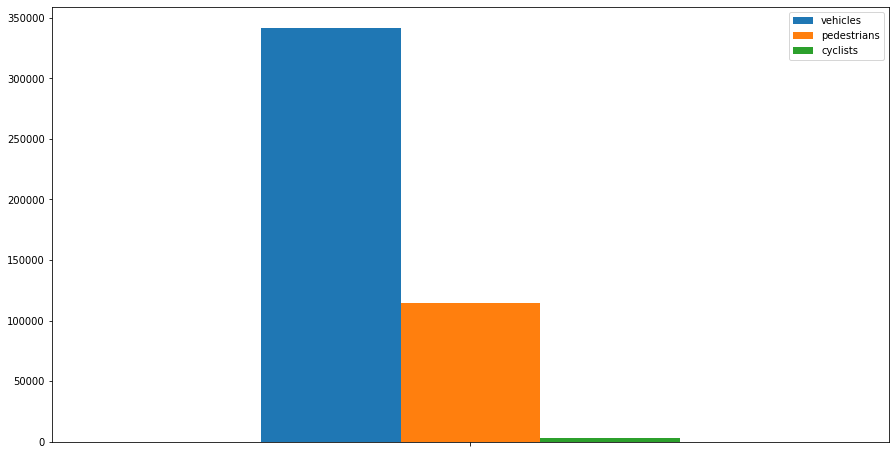

In [ ]:
import pandas as pd
df = pd.DataFrame.from_dict({'vehicles':[counter_dict[1]], 'pedestrians': [counter_dict[2]], 'cyclists': [counter_dict[4]]})
_, ax = plt.subplots(1, figsize=(15,8))
df.plot(kind='bar',ax=ax)
ax.set_xticklabels('');

## Cross validation and split data

In this section we will use our knowledge of EDA to strategically split the data.

Ideally We would want the same distribution of vehicles, pedestrians and cyclists in all of our splitted datasets. In other words each dataset (train, test, valid) should have the following distribution:

* 74% vehicles
* 25% pedestrians
* 1% cyclist

In [5]:
!python create_splits.py --data_dir ../data/processed/

|      |   train[tfrecords] |   test[tfrecords] |   val[tfrecords] |
|:-----|-------------------:|------------------:|-----------------:|
| size |                 75 |                15 |               10 |


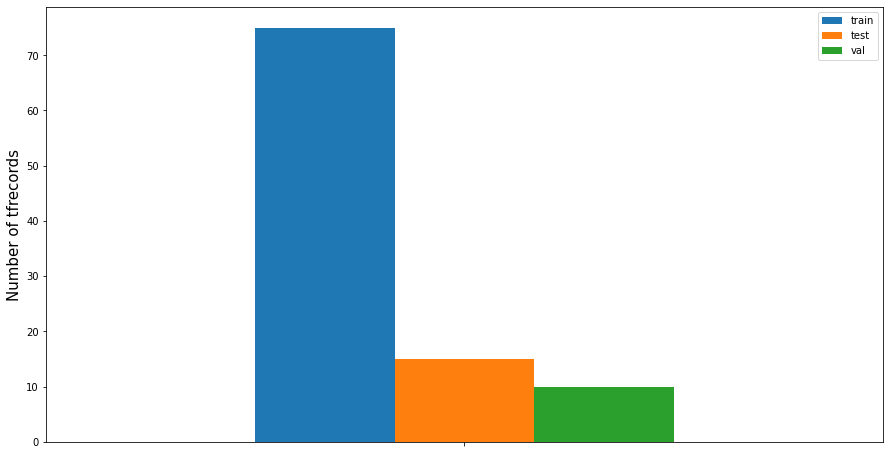

In [9]:
# values taken from above results
train_size = 75
test_size = 15
val_size = 10  
df = pd.DataFrame({'train':[train_size], 'test': [test_size], 'val': [val_size]},
                            index=['size'])

_, ax = plt.subplots(1, figsize=(15,8))
df.plot(kind='bar',ax=ax)
ax.set_ylabel('Number of tfrecords', fontsize=15)
ax.set_xticklabels('');

### Testin results of new split files

INFO:tensorflow:Reading unweighted datasets: ['../data/processed/val/val-7.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['../data/processed/val/val-7.tfrecord']
INFO:tensorflow:Number of filenames to read: 1


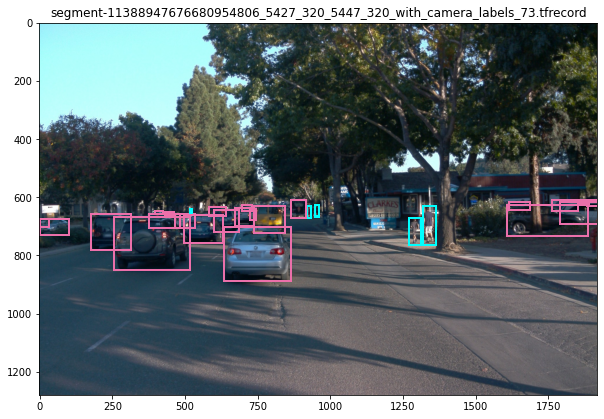

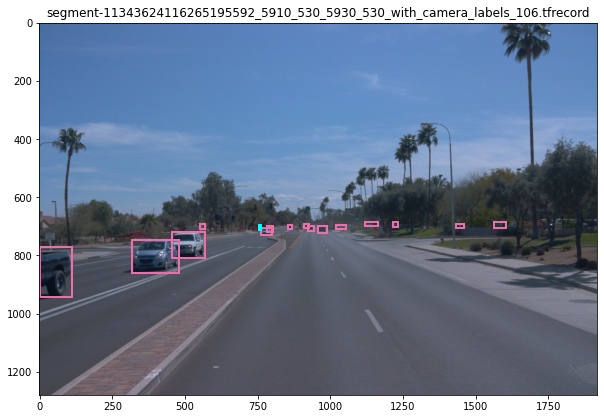

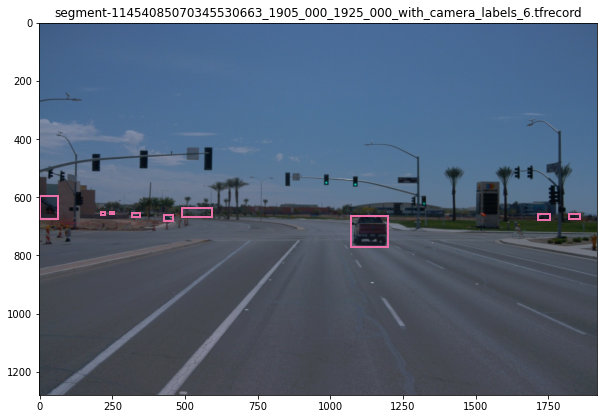

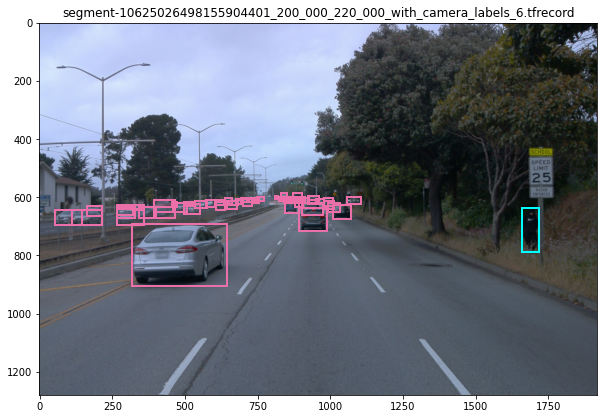

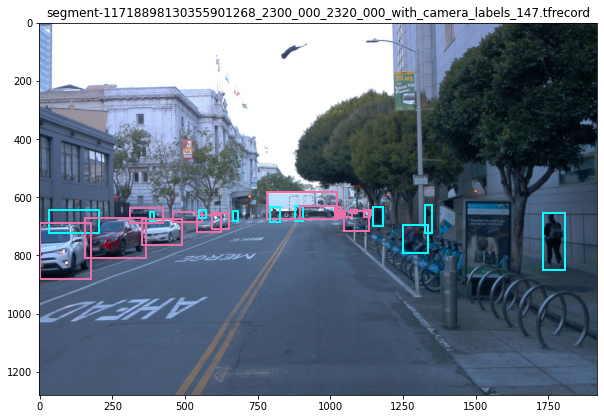

In [ ]:
valid_test = get_dataset("../data/processed/val/val-7.tfrecord")
#valid_test.shuffle(10)
valid_test.repeat(1)
for batch in valid_test.take(5):
    display_instances(batch)

In [ ]:
!wget download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz 
!mkdir -p training/pretrained-models
!mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz ./training/pretrained-models/
!tar -xvzf ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz -C ./training/pretrained-models/
!rm -rf ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

--2020-11-28 19:16:11--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.203.128, 2607:f8b0:400c:c07::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.203.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   104MB/s    in 2.2s    

2020-11-28 19:16:14 (104 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]

ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/checkpoint
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_resne

In [ ]:
!python edit_config.py --train_dir ../data/processed/train/ --eval_dir ../data/processed/val/ --batch_size 30 --checkpoint ./training/pretrained-models/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0 --label_map label_map.pbtxt

2020-11-29 01:53:51.640717: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1


In [ ]:
!mkdir ./training/reference
!mv pipeline_new.config ./training/reference/

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py --model_dir=training/reference/ --pipeline_config_path=training/reference/pipeline_new.config

2020-11-29 02:36:02.984831: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-11-29 02:36:05.426647: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-11-29 02:36:05.436493: E tensorflow/stream_executor/cuda/cuda_driver.cc:314] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2020-11-29 02:36:05.436551: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (81d55dec86e7): /proc/driver/nvidia/version does not exist
2020-11-29 02:36:05.436991: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN)to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2020-11

In [ ]:
%tensorboard --logdir=training

Reusing TensorBoard on port 6006 (pid 36009), started 0:24:26 ago. (Use '!kill 36009' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py --model_dir=training/reference/ --pipeline_config_path=training/reference/pipeline_new.config --checkpoint_dir=training/reference/

2020-11-29 02:47:10.199889: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
W1129 02:47:14.580874 140657609291648 model_lib_v2.py:1026] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1129 02:47:14.581129 140657609291648 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1129 02:47:14.581229 140657609291648 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1129 02:47:14.581325 140657609291648 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1129 02:47:14.581512 140657609291648 model_lib_v2.py:1041] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2020-11-29 02:47:14.646996: I tensorflow/stream_executor/